# __Melbourne Housing Prediction - Machine Learning Project__
---


## About Our Group 

- BS20DSY031 - Tuan Nguyen
- BS20DSY029 - Thanh Nguyen
- BS20DSY033 - Minh Le
- BS20DSY041 - Hai Nguyen

# 1. Introduction¶

*   The aim of this notebook is to build useful models that can predict Melbourne (located in Victoria) housing prices based on a set of scrapped features made available in the Melbourne Housing Dataset. Also, it provides practice insights for house buyers into the Melbourne Housing Market.
 

*   The dataset is very interesting to explore since Melbourne is one of the world's most liveable cities. It's also interesting to explore the Plotly library capability & create interactive choropleth maps, similar to the notebook I wrote about Australian Geographic Data Plots.



In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly
from plotly.subplots import make_subplots
from sklearn import preprocessing
import seaborn as sns
from scipy import stats

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.figure_factory as ff
from sklearn.base import BaseEstimator,TransformerMixin

%matplotlib inline
cmap = sns.diverging_palette(220, 10, as_cmap=True)

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', 50)

line_colors = ["#7CEA9C", '#50B2C0', "rgb(114, 78, 145)", "hsv(348, 66%, 90%)", "hsl(45, 93%, 58%)"]

/opt/conda/lib/python3.7/site-packages/geopandas/_compat.py:115: UserWarning:

The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.



# 2. Melbourne Housing Dataset

## 2.1. Data Preparation

Let's review some of the features that are available in the **Melbourne Housing Dataset**.

- Suburb: Suburb

- Address: Address

- Rooms: Number of rooms

- Price: Price in Australian dollars

- Method:  
S - property sold;  
SP - property sold prior;  
PI - property passed in;  
PN - sold prior not disclosed;  
SN - sold not disclosed;  
NB - no bid;  
VB - vendor bid;  
W - withdrawn prior to auction;  
SA - sold after auction;  
SS - sold after auction price not disclosed.  
N/A - price or highest bid not available.  

- Type:  
    br - bedroom(s);  
    h - house,cottage,villa, semi,terrace;  
    u - unit, duplex;  
    t - townhouse;  
    dev site - development site;  
    o res - other residential.  

- SellerG: Real Estate Agent

- Date: Date sold

- Distance: Distance from CBD in Kilometres

- Regionname: General Region (West, North West, North, North east …etc)

- Propertycount: Number of properties that exist in the suburb.

- Bedroom2 : Scraped # of Bedrooms (from different source)

- Bathroom: Number of Bathrooms

- Car: Number of carspots

- Landsize: Land Size in Metres

- BuildingArea: Building Size in Metres

- YearBuilt: Year the house was built

- CouncilArea: Governing council for the area

- Lattitude: Self explanitory

- Longtitude: Self explanitory



In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/monilshah98/Melbourne-House-Price-Prediction/master/DataSet/Melbourne_Housing_Dataset.csv')

In [3]:
df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,2.0,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,2.0,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,2.0,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,3.0,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,3.0,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          27247 non-null  float64
 5   Method         34857 non-null  object 
 6   SellerG        34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom2       26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

> We have total 34854 housing transactional records. However, there are significant numbers of null values, we will do some data cleaning first before conducting Exploratory Data Analysis.

There are many rows with missing values of the
target variable (**Price**).  

Since the imputation of these values could increase bias in input data, we should remove all the records whose NaN values in **Price**. 

In [5]:
df.dropna(subset=['Price'], how='all', inplace=True)

In [6]:
# Some Data Cleaning 
df.drop_duplicates(subset=['Address'],inplace=True) # Some addresses actually have multiple entries
df.rename ({'Bedroom2': 'Bedrooms'}, axis = 1, inplace = True)
# df.index = df['Address'] # set dataframe index, since it's not really a useful feature 
# del df['Address'] # let's also delete the column

> Columns with more than 55% values missing should be removed
from the original dataset since it is difficult to impute these
missing values with an acceptable level of accuracy. 

In [7]:
missing_percentages = df.isnull().sum(axis = 0) / len(df) 
print(missing_percentages)
df = df.loc[:, (missing_percentages < 0.55)]

Suburb           0.000000
Address          0.000000
Rooms            0.000000
Type             0.000000
Price            0.000000
Method           0.000000
SellerG          0.000000
Date             0.000000
Distance         0.000037
Postcode         0.000037
Bedrooms         0.237150
Bathroom         0.237374
Car              0.251131
Landsize         0.340548
BuildingArea     0.609921
YearBuilt        0.557362
CouncilArea      0.000112
Lattitude        0.230309
Longtitude       0.230309
Regionname       0.000112
Propertycount    0.000112
dtype: float64


Next, we will create a helper class which will be used to visualize missing data and feature importances.

In [8]:
# !pip install shap
# !pip install catboost
from sklearn.base import BaseEstimator, TransformerMixin
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import shap
from catboost import CatBoostClassifier,CatBoostRegressor
from sklearn.feature_selection import SelectKBest,f_regression
from xgboost import plot_importance,XGBClassifier,XGBRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import preprocessing


#Notebook Helper Class
class transformer(BaseEstimator, TransformerMixin):
    def __init__(self, drop_nan=False, show_nan=False, select_dtype=False, title='Title', figsize=(None,None), feature_importance = False, target = 'Price'):
        self.drop_nan = drop_nan
        self.show_nan = show_nan
        self.select_dtype = select_dtype
        self.title = title
        self.feature_importance = feature_importance
        self.figsize = figsize
        self.target = target


  # Apply Some Transformation to the Feature Matrix
    def transform(self, X):

    
    #'''show NaN % in DataFrame'''
        if(self.show_nan):
        
            fig, ax = plt.subplots(figsize = self.figsize)
            nan_val = (X.isnull().sum()/len(X)*100).sort_values(ascending = False)
            cmap = sns.color_palette("plasma")
            for i in ['top', 'right', 'bottom', 'left']:
                ax.spines[i].set_color('black')
                ax.spines['top'].set_visible(True);ax.spines['right'].set_visible(False)
                ax.spines['bottom'].set_visible(False);ax.spines['left'].set_visible(False)
                sns.barplot(x=nan_val,y=nan_val.index, edgecolor='k',palette = 'rainbow')
                plt.title(self.title);ax.grid(ls='--',alpha = 0.9);plt.show()
                return


    #''' Drop All NaN values in DataFrame'''
        if(self.drop_nan):
            X = X.dropna();
            return X

        if self.select_dtype:
            num = X.loc[:,X.dtypes != 'object']
            cat = X.loc[:,X.dtypes == 'object']
            return num, cat

        if self.feature_importance:

        # Plot Correlation to Target Variable only
            def corrMat2(df,target=self.target,figsize=(9,0.5),ret_id=False):

                corr_mat = df.corr().round(2);shape = corr_mat.shape[0]
                corr_mat = corr_mat.transpose()
                corr = corr_mat.loc[:, df.columns == self.target].transpose().copy()

                if(ret_id is False):
                    f, ax = plt.subplots(figsize=figsize)
                    sns.heatmap(corr,vmin=-0.3,vmax=0.3,center=0, 
                          cmap=cmap,square=False,lw=2,annot=True,cbar=False)
                    plt.title(f'Feature Correlation to {self.target}')

                if(ret_id):
                    return corr

            def feature_importance(df, feature=self.target, n_est=500):
                num_df0,_ = transformer(select_dtype=True).transform(X=df)
                num_df = transformer(drop_nan=True).transform(X=num_df0)
      
        #  Input dataframe contains numeric features and target feature
                X = num_df.copy()
                y = num_df[feature].copy()
                del X[feature]

        #  CORRELATION
                imp = corrMat2(num_df,feature,figsize=(15,0.5),ret_id=True)
                del imp[feature]
                s1 = imp.squeeze(axis=0);s1 = abs(s1)
                s1.name = 'Correlation'

        #   SHAP
                model = CatBoostRegressor(silent=True,n_estimators=n_est).fit(X,y)
                explainer = shap.TreeExplainer(model)
                shap_values = explainer.shap_values(X)
                shap_sum = np.abs(shap_values).mean(axis=0)
                s2 = pd.Series(shap_sum,index=X.columns,name='Cat_SHAP').T

        #   RANDOMFOREST
                model = RandomForestRegressor(n_est,random_state=0, n_jobs=-1)
                fit = model.fit(X,y)
                rf_fi = pd.DataFrame(model.feature_importances_,index=X.columns,
                            columns=['RandForest']).sort_values('RandForest',ascending=False)
                s3 = rf_fi.T.squeeze(axis=0)

        #   XGB 
                model=XGBRegressor(n_estimators=n_est,learning_rate=0.5,verbosity = 0)
                model.fit(X,y)
                data = model.feature_importances_
                s4 = pd.Series(data,index=X.columns,name='XGB').T

        #   KBEST
                model = SelectKBest(k=X.shape[1], score_func=f_regression)
                fit = model.fit(X,y)
                data = fit.scores_
                s5 = pd.Series(data,index=X.columns,name='K_best')

        # Combine Scores
                df0 = pd.concat([s1,s2,s3,s4,s5],axis=1)
                df0.rename(columns={'target':'lin corr'})

                x = df0.values 
                min_max_scaler = preprocessing.MinMaxScaler()
                x_scaled = min_max_scaler.fit_transform(x)
                df = pd.DataFrame(x_scaled,index=df0.index,columns=df0.columns)
                df = df.rename_axis('Feature Importance via', axis=1)
                df = df.rename_axis('Feature', axis=0)
                df['total'] = df.sum(axis=1)
                df = df.sort_values(by='total',ascending=True)
                del df['total']
                fig = px.bar(df,orientation='h',barmode='stack',color_discrete_sequence=line_colors)
                fig.update_layout(template='plotly_white',height=self.figsize[1],width=self.figsize[0],margin={"r":0,"t":60,"l":0,"b":0});
                for data in fig.data:
                    data["width"] = 0.6 #Change this value for bar widths
                fig.show()
        
        feature_importance(X)

# 2.2. Categorical & Ordinal Features
- We have a few categorical features which can be handy for EDA, as well as for model features, such as One-Hot Encoding/ GetDummies.
Sold_Month & Sold_Year can be extracted from Date.

- SUBURB probably doesn't tell us any more than the POSTCODE does, but useful for EDA.


In [9]:
#Divide features into categorical and ordinal
df.Postcode = df.Postcode.astype('object') #Convert Postcode in to object data type
df_num, df_cat = transformer(select_dtype=True).transform(X=df.copy())


#Create Sold_Month & Sold_Year
df_num[['Sold_Month', 'Sold_Year']] = df_cat['Date'].str.split('/', 2, expand=True).loc[:,1:2].astype('float64')
df_cat.drop(['Date'], inplace=True, axis=1)

df_EDA = pd.concat([df_cat, df_num], axis=1)

# 3. UNIVARIATE DATA ANALYSIS

## 3.1. Data Distributions Histograms


In [10]:
import plotly.offline as pyo
pyo.init_notebook_mode()

In [11]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go

# Plot Histogram, Boxplot using Plotly
def px_stats(df, n_cols=4, to_plot=None, height=800, w=None):
    df_num, df_cat = transformer(select_dtype=True).transform(df)
    numeric_cols = df_num.columns
    n_rows = -(-len(numeric_cols) // n_cols)
    row_pos, col_pos = 1, 0
    fig = make_subplots(rows=n_rows, cols=n_cols,subplot_titles=numeric_cols.to_list())

    for col in numeric_cols:
        if (to_plot == 'histogram'):
            trace = go.Histogram(x=df_num[col],showlegend=False,autobinx=True,
                                marker = dict(color = 'rgb(27, 79, 114)',
                                line=dict(color='white',width=0)))
        else:
            trace = getattr(px, to_plot)(df_num[col],x=df_num[col])["data"][0]
          
        if col_pos == n_cols: 
            row_pos += 1
        col_pos = col_pos + 1 if (col_pos < n_cols) else 1
        fig.add_trace(trace, row=row_pos, col=col_pos)

    fig.update_traces(marker = dict(color = 'rgb(27, 79, 114)',
                    line=dict(color='white',width=0)))
    fig.update_layout(template='plotly_white');fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0})
    fig.update_layout(height=height,width=w)
    fig.show()

- The most common price range of a property; 500k-1000k AUD, which makes up about 50% of all properties.
- We can note 1-bedroom properties are quite uncommon in Melbourne, the most common being a 3-bedroom property, typically having 1 or 2 bathrooms & garage with 1 or 2 car slots.
- The last months of a year like September, October, November are the months with the highest sales activity and then it decreases until hitting the lowest point in next January.
- Some of the properties have a very large number of garages slots so it would make sense to just remove them but lets just keep them anyway. Quite a large number of features have *skewed distributions*. Let's note to do some cleaning.

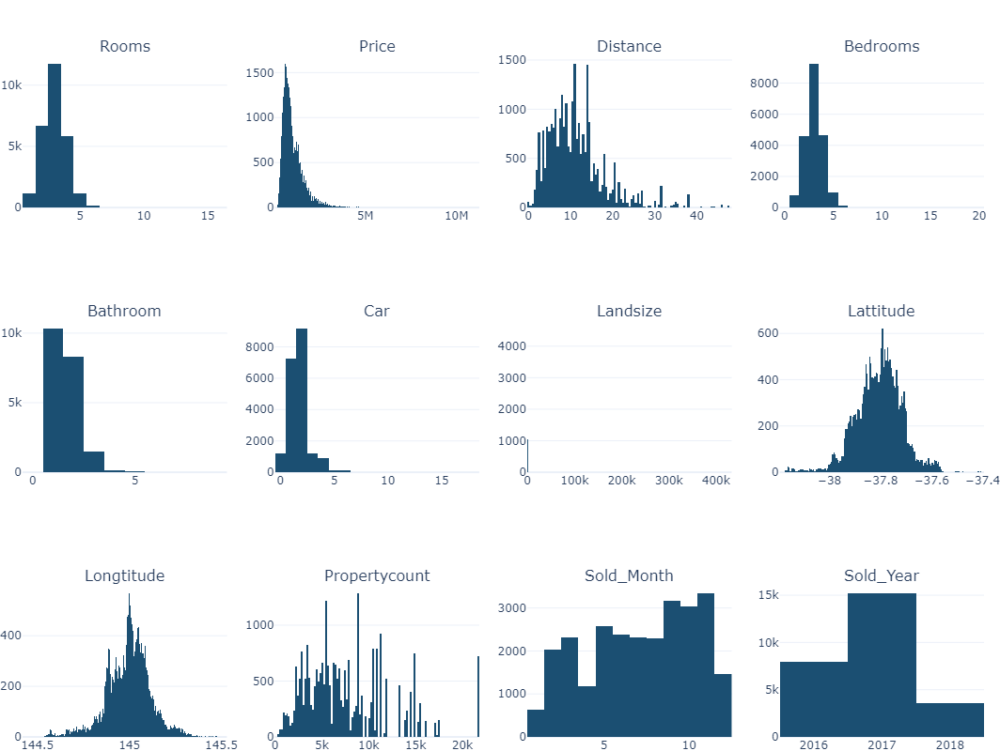

In [12]:
px_stats(df_EDA, to_plot='histogram') # interactive

## 3.2. Data Distributions Boxplots
- Complementary to histograms, boxplots, indicate outliers a little more clearly, as well as useful statistics about min, max, median & q1/q3 values.

- We will lean towards using tree based methods; It is often stated that, ensemble approaches such as *Random Forest* are not sensitive to outliers, however there are counter arguments that state the complete opposite as shown on stackexchange.

- That said our data contains quite a lot of outliers, which is to be expected from a non consistent selling standard/rules for properties, allowing certain properties to be prices above/below values of similar properties depending on specific circumstaces.

- It is interesting to look into creating models for a specific subset of our data ( eg. similar suburbs, low cost suburbs, presold properties and so on ), in an attempt to get around these outliers. One model for the entire dataset seems like a huge stretch, and most definitely will have accuracy limits.

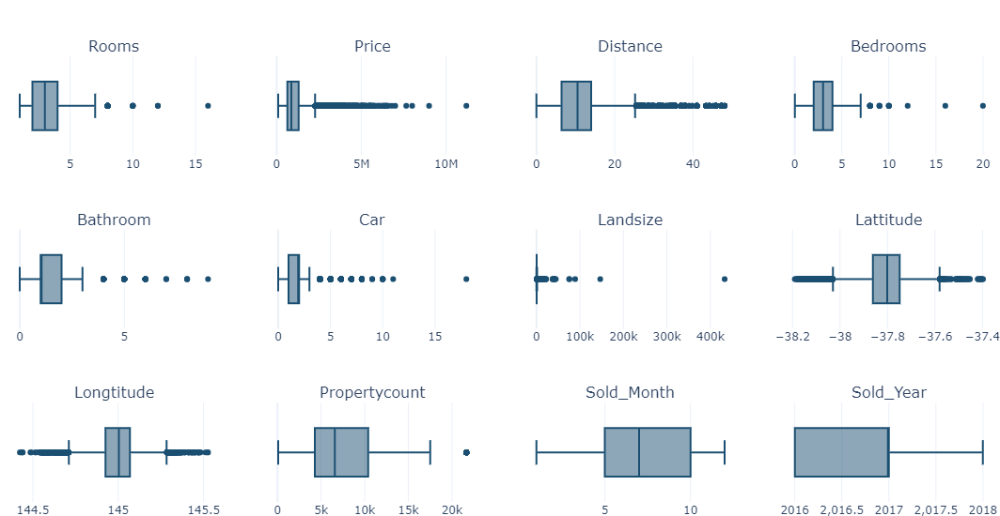

In [13]:
px_stats(df_EDA, to_plot='box',height=550)


## 3.3. Target Model Feature Importance Evaluation

- We can use multiple approaches, even early on, to quickly evaluate which features have most weight in a model evaluation to get a better understanding of not only their imporance but also how different models use these features in their evaluation. 

- It is easy to understand that **Distance** (to CBD), **Number of rooms**, **Number of Bathrooms**, **Number of Bedrooms** are the most important features.

- Although there are a number of features that have little to no impact, the only irrelevant feature seems to be **Sold_Month**, **Sold_Year**, **Property_count** which we ought to drop, a little later.




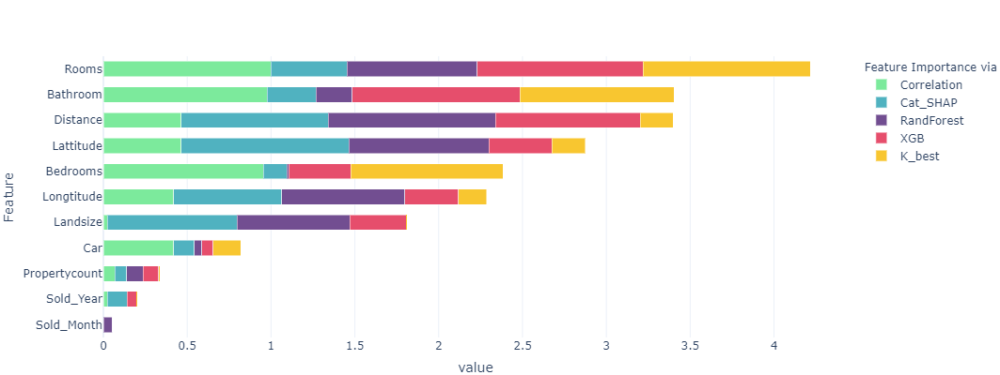

In [14]:
transformer(feature_importance=True,figsize=(800,400),target='Price').transform(X=df_EDA)

In [15]:
df_EDA.drop(columns = ['Propertycount', 'Sold_Month', 'Sold_Year'], inplace = True)

> Besides, we will try to create a new feature "Distance_to_station" to see if it has any impact on the house prices or not. The code will be implemented in a separate .ipynb file.

# 4. Missing Data & Cleaning
We have 6 features with missing data: Landsize, Car, Bathroom, Bedroom, Longtitude, Lattitude.

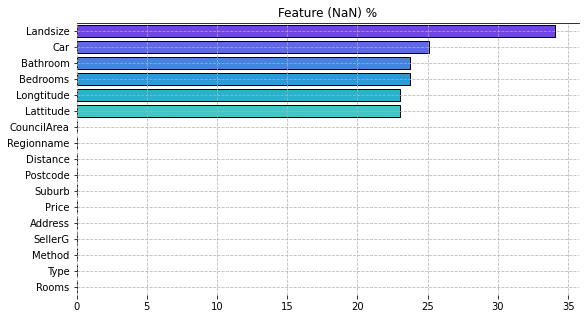

In [16]:
transformer(show_nan=True,figsize=(9,5),title='Feature (NaN) %').transform(X=df_EDA)

### **Landsize** Imputation

Firstly, we will remove records whose land sizes of less than 10 square meters are removed. They are outliers which may stem from factors such as human errors, relationship with probability models, and even structured situations.

In [17]:
df_EDA.shape

(26751, 17)

In [18]:
df_EDA['Landsize'].sort_values()

12895    0.0
11767    0.0
11749    0.0
4160     0.0
4162     0.0
        ... 
34832    NaN
34838    NaN
34840    NaN
34844    NaN
34855    NaN
Name: Landsize, Length: 26751, dtype: float64

In [19]:
df_EDA = df_EDA[df_EDA['Landsize'] >= 10]

In [20]:
df_EDA.Landsize

1        202.0
2        156.0
4        134.0
5         94.0
6        120.0
         ...  
34849    404.0
34851    288.0
34853     98.0
34854    220.0
34856    250.0
Name: Landsize, Length: 15716, dtype: float64

As we have some huge Land size value then it will affect the mean land size, we will impute the Land size values by using its median values group by house types and suburbs.

In [21]:
df_EDA['Landsize'] = df_EDA['Landsize'].fillna(df_EDA.groupby(['Type','Suburb'])['Landsize'].transform('median'))

In [22]:
df_EDA['Landsize'].isna().sum()

0

In [23]:
df_EDA.isna().sum()

Suburb           0
Address          0
Type             0
Method           0
SellerG          0
Postcode         0
CouncilArea      0
Regionname       0
Rooms            0
Price            0
Distance         0
Bedrooms         6
Bathroom         9
Car            274
Landsize         0
Lattitude       19
Longtitude      19
dtype: int64

### **Bedroom**, **Bathroom**, **Car** Imputation

We will impute the **Bedroom**, **Bathroom**, **Car** values by using its median values group by house types.

In [24]:
df_EDA['Bedrooms'] = df_EDA['Bedrooms'].fillna(df_EDA.groupby('Type')['Bedrooms'].transform('median'))
df_EDA['Bathroom'] = df_EDA['Bathroom'].fillna(df_EDA.groupby('Type')['Bathroom'].transform('median'))
df_EDA['Car'] = df_EDA['Car'].fillna(df_EDA.groupby('Type')['Car'].transform('median'))

In [25]:
df_EDA.isna().sum()

Suburb          0
Address         0
Type            0
Method          0
SellerG         0
Postcode        0
CouncilArea     0
Regionname      0
Rooms           0
Price           0
Distance        0
Bedrooms        0
Bathroom        0
Car             0
Landsize        0
Lattitude      19
Longtitude     19
dtype: int64

### **Lattitude**, **Longtitude** Imputation
We will try to fill null values in these features from house addresses using GeoPy. 


In [26]:
# !pip install geopy

In [27]:
#!pip install plotly

In [28]:
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
 
#Creating a dataframe with address of locations we want to reterive
condition = df_EDA['Longtitude'].isna()
df_address = pd.DataFrame((df_EDA[condition]['Address']))
df_address['Full_address'] = df_EDA[condition]['Address'] + ' ' + df_EDA[condition].Suburb
# df_address["Address"] = df_address["Address"] + df_EDA[condition].Suburb
# df_address.columns = 

# #Creating an instance of Nominatim Class
geolocator = Nominatim(user_agent="my_request")
 
# #applying the rate limiter wrapper
geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
 
# #Applying the method to pandas DataFrame
df_address['location'] = df_address['Full_address'].apply(geocode)
df_address['Lat'] = df_address['location'].apply(lambda x: x.latitude if x else None)
df_address['Lon'] = df_address['location'].apply(lambda x: x.longitude if x else None)

In [29]:
df_EDA['Lattitude'] = df_EDA['Lattitude'].combine_first(df_EDA['Address'].map(df_address.set_index('Address')['Lat']))
df_EDA['Longtitude'] = df_EDA['Longtitude'].combine_first(df_EDA['Address'].map(df_address.set_index('Address')['Lon']))

# 5. EXPLORATORY DATA ANALYSIS

In [30]:
main_df = pd.read_csv ('../input/preprocessed-data/preprocessed_data.csv').drop(columns = ['Unnamed: 0'])

In [32]:
main_df

,Suburb,Address,Type,Method,SellerG,CouncilArea,Regionname,Rooms,Price,Distance,Postcode,Bedrooms,Bathroom,Car,Landsize,main_lat,main_lon,Propertycount,Sold_Month,Sold_Year,station,metro_lat,metro_lon,Distance_to_Station
0,Abbotsford,85 Turner St,h,S,Biggin,Yarra City Council,Northern Metropolitan,2,1480000.0,2.5,3067.0,2.0,1.0,1.0,202.0,-37.79960,144.99840,4019.0,12.0,2016.0,Victoria Park,-37.799381,144.994407,0.3517
1,Abbotsford,25 Bloomburg St,h,S,Biggin,Yarra City Council,Northern Metropolitan,2,1035000.0,2.5,3067.0,2.0,1.0,0.0,156.0,-37.80790,144.99340,4019.0,2.0,2016.0,North Richmond,-37.810076,144.992556,0.2531
2,Abbotsford,5 Charles St,h,SP,Biggin,Yarra City Council,Northern Metropolitan,3,1465000.0,2.5,3067.0,3.0,2.0,0.0,134.0,-37.80930,144.99440,4019.0,3.0,2017.0,North Richmond,-37.810076,144.992556,0.1835
3,Abbotsford,40 Federation La,h,PI,Biggin,Yarra City Council,Northern Metropolitan,3,850000.0,2.5,3067.0,3.0,2.0,1.0,94.0,-37.79690,144.99690,4019.0,3.0,2017.0,Victoria Park,-37.799381,144.994407,0.3523
4,Abbotsford,55a Park St,h,VB,Nelson,Yarra City Council,Northern Metropolitan,4,1600000.0,2.5,3067.0,3.0,1.0,2.0,120.0,-37.80720,144.99410,4019.0,6.0,2016.0,Collingwood,-37.804543,144.993743,0.2971
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15710,Wollert,35 Kingscote Wy,h,SP,RW,Whittlesea City Council,Northern Metropolitan,3,570000.0,25.5,3750.0,3.0,2.0,2.0,404.0,-37.61031,145.03393,2940.0,2.0,2018.0,Epping,-37.653017,145.028607,4.7719
15711,Yarraville,78 Bayview Rd,h,S,Jas,Maribyrnong City Council,Western Metropolitan,3,1101000.0,6.3,3013.0,3.0,1.0,2.0,288.0,-37.81095,144.88516,6543.0,2.0,2018.0,Yarraville,-37.815813,144.889975,0.6865
15712,Yarraville,29A Murray St,h,SP,Sweeney,Maribyrnong City Council,Western Metropolitan,2,888000.0,6.3,3013.0,2.0,2.0,1.0,98.0,-37.81551,144.88826,6543.0,2.0,2018.0,Yarraville,-37.815813,144.889975,0.1544
15713,Yarraville,147A Severn St,t,S,Jas,Maribyrnong City Council,Western Metropolitan,2,705000.0,6.3,3013.0,2.0,1.0,2.0,220.0,-37.82286,144.87856,6543.0,2.0,2018.0,Spotswood,-37.830651,144.885942,1.0821


### **5.1. Categorical EDA**

In [ ]:
#Type, Method, Region name

In [33]:
import plotly.express as px
import plotly.offline as pyo
pyo.init_notebook_mode()

*Among 3 type of accomodation (t, u, h), type_h appears to be more slightly expensive than other*

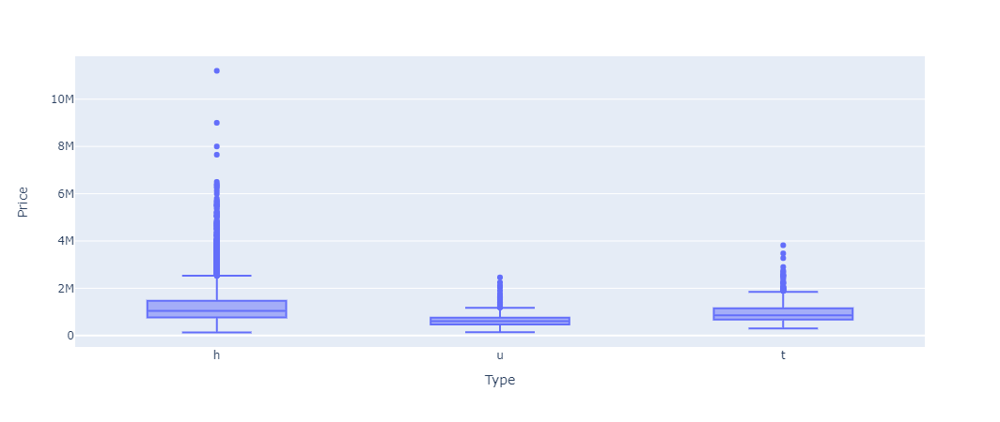

In [34]:
fig = px.box(main_df, y="Price", x = 'Type')
fig.show()

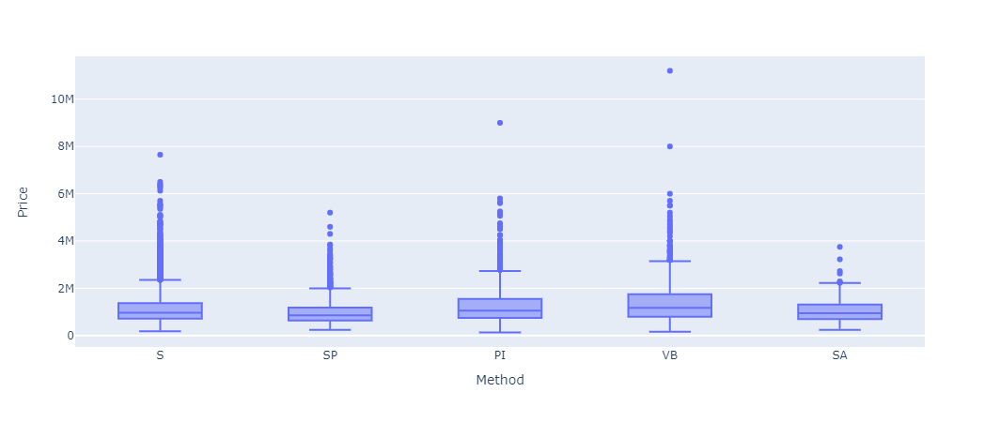

In [35]:
fig = px.box(main_df, y = "Price", x = "Method")
fig.show()

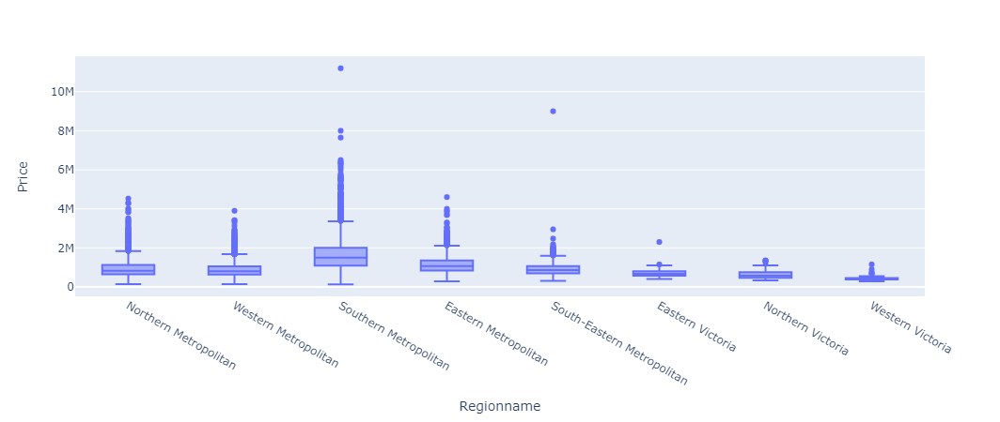

In [36]:
fig = px.box(main_df, y = "Price", x = "Regionname")
fig.show()

### *Top 10 Suburb that have the largest median of price of house*

In [37]:
top_price = main_df.groupby ('Suburb').median(['Price']).reset_index().sort_values (by = ['Price'], ascending = False).reset_index().drop(columns = ['index']).head(10)
box_top_price_data = main_df.loc[main_df.Suburb.isin(top_price.Suburb.to_list())]

In [38]:
box_top_price_data

,Suburb,Address,Type,Method,SellerG,CouncilArea,Regionname,Rooms,Price,Distance,Postcode,Bedrooms,Bathroom,Car,Landsize,main_lat,main_lon,Propertycount,Sold_Month,Sold_Year,station,metro_lat,metro_lon,Distance_to_Station
65,Albert Park,105 Kerferd Rd,h,S,hockingstuart,Port Phillip City Council,Southern Metropolitan,2,1275000.0,3.3,3206.0,2.0,1.0,0.0,120.0,-37.84590,144.95550,3280.0,9.0,2016.0,Prahran,-37.849763,144.989817,3.0436
66,Albert Park,85 Richardson St,h,S,Thomson,Port Phillip City Council,Southern Metropolitan,2,1455000.0,3.3,3206.0,2.0,1.0,0.0,159.0,-37.84500,144.95380,3280.0,9.0,2016.0,Southern Cross,-37.818354,144.952193,2.9663
67,Albert Park,112 Beaconsfield Pde,h,PI,Buxton,Port Phillip City Council,Southern Metropolitan,3,2850000.0,3.3,3206.0,3.0,2.0,0.0,211.0,-37.84810,144.94990,3280.0,3.0,2017.0,Southern Cross,-37.818354,144.952193,3.3137
68,Albert Park,94 Graham St,h,S,Greg,Port Phillip City Council,Southern Metropolitan,3,1850000.0,3.3,3206.0,3.0,2.0,0.0,128.0,-37.84520,144.94880,3280.0,3.0,2017.0,Southern Cross,-37.818354,144.952193,3.0000
69,Albert Park,396 Montague St,h,S,RT,Port Phillip City Council,Southern Metropolitan,2,1436000.0,3.3,3206.0,2.0,1.0,0.0,130.0,-37.84310,144.95650,3280.0,3.0,2017.0,Southern Cross,-37.818354,144.952193,2.7775
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15522,Middle Park,123 Hambleton St,h,S,Greg,Port Phillip City Council,Southern Metropolitan,3,1720000.0,3.0,3206.0,3.0,2.0,1.0,108.0,-37.84812,144.96240,2019.0,2.0,2018.0,Prahran,-37.849763,144.989817,2.4142
15523,Middle Park,22 McGregor St,h,S,Greg,Port Phillip City Council,Southern Metropolitan,3,3250000.0,3.0,3206.0,3.0,2.0,1.0,286.0,-37.85205,144.96481,2019.0,2.0,2018.0,Prahran,-37.849763,144.989817,2.2103
15524,Middle Park,123 Neville St,h,S,Greg,Port Phillip City Council,Southern Metropolitan,3,1712000.0,3.0,3206.0,3.0,2.0,2.0,125.0,-37.85086,144.96317,2019.0,2.0,2018.0,Prahran,-37.849763,144.989817,2.3428
15537,Mont Albert,7 Gordon St,h,PI,Woodards,Boroondara City Council,Eastern Metropolitan,3,1600000.0,10.2,3127.0,3.0,1.0,2.0,832.0,-37.82141,145.10169,2079.0,2.0,2018.0,Surrey Hills,-37.824054,145.098639,0.3978


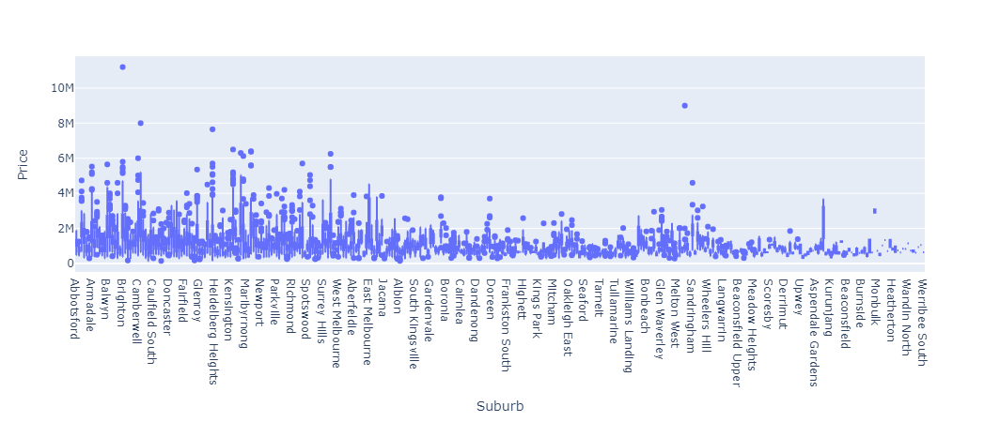

In [39]:
fig = px.box(main_df, y = "Price", x = "Suburb")

fig.show()

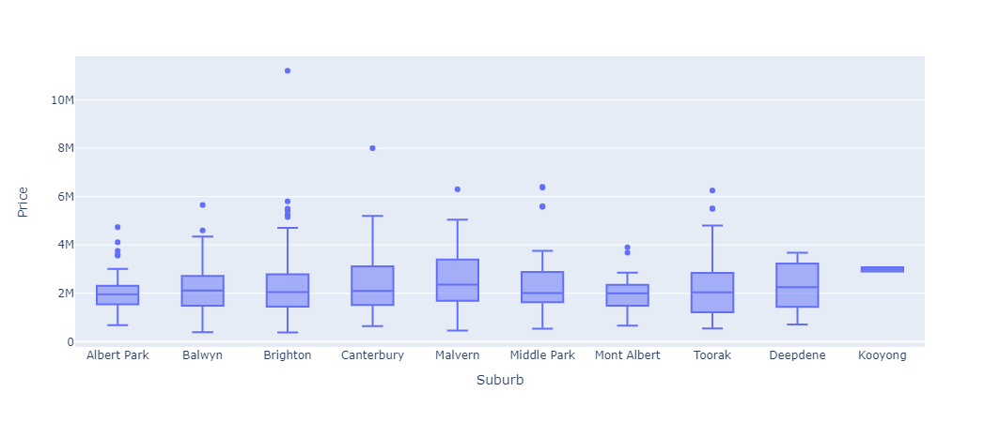

In [40]:
fig = px.box(box_top_price_data, y = "Price", x = "Suburb")
fig.show()

### **5.2. Houses sold group by *['type', 'suburb']***

In [41]:
count_type_suburb = main_df.groupby(['Suburb', 'Type'])['Address'].count().reset_index()
count_type_suburb.rename ({'Address':'Sold_Count'}, axis = 1, inplace = True)
count_type_suburb_sum = count_type_suburb.groupby (['Suburb'])['Sold_Count'].sum().reset_index()
count_type_suburb_sum = count_type_suburb_sum.sort_values (['Sold_Count'], ascending = False).reset_index()
count_type_suburb_sum.drop(columns = ['index', 'Sold_Count'], inplace = True)
count_type_suburb_sum['Order'] = [i for i in range (len(count_type_suburb_sum))]
count_type_suburb_sum

,Suburb,Order
0,Reservoir,0
1,Bentleigh East,1
2,Preston,2
3,Richmond,3
4,Brunswick,4
...,...,...
326,Healesville,326
327,Kalkallo,327
328,Cranbourne West,328
329,Research,329


In [42]:
sorted_count_type_suburb = count_type_suburb_sum.merge(count_type_suburb, how = 'right', on = ['Suburb'])
sorted_count_type_suburb = sorted_count_type_suburb.sort_values (['Order'])
sorted_count_type_suburb = sorted_count_type_suburb.reset_index().drop(columns = ['index'])
sorted_count_type_suburb


,Suburb,Order,Type,Sold_Count
0,Reservoir,0,h,315
1,Reservoir,0,t,24
2,Reservoir,0,u,67
3,Bentleigh East,1,u,29
4,Bentleigh East,1,t,56
...,...,...,...,...
713,Healesville,326,h,1
714,Kalkallo,327,h,1
715,Cranbourne West,328,h,1
716,Research,329,h,1


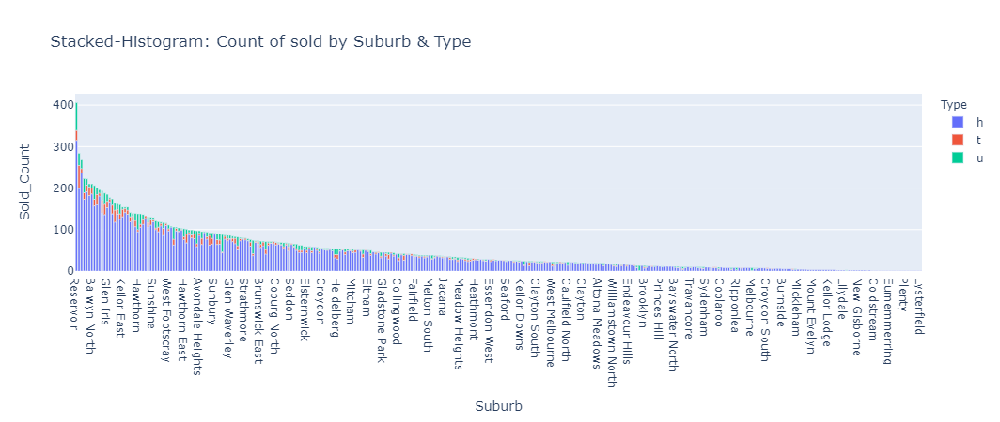

In [43]:
#stacked bar?? should be in a specific period of time.

fig = px.bar(sorted_count_type_suburb, x="Suburb", y="Sold_Count", color="Type", title="Stacked-Histogram: Count of sold by Suburb & Type")
fig.show()

### **5.3. Numberical EDA**

In [44]:
main_df_numer = main_df.loc[:, ['Address','Price','Bathroom', 'Distance', 'Bedrooms', 'Car', 'Rooms', 'Distance_to_Station', 'Landsize', 'main_lon', 'main_lat']]

#### *Features correlation*

<AxesSubplot:title={'center':'Features correlation betweens numerical features'}>

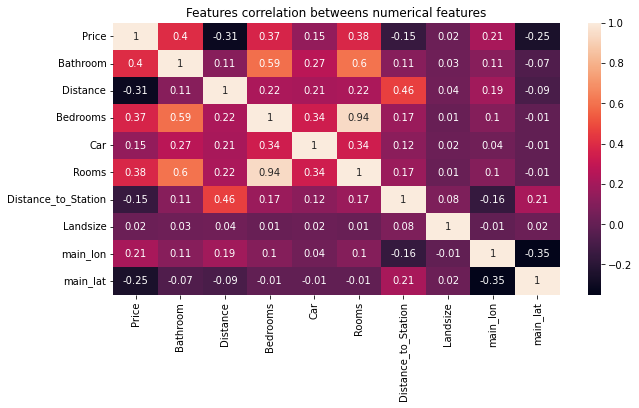

In [45]:
plt.figure (figsize = (10,5))
plt.title ('Features correlation betweens numerical features')
sns.heatmap(main_df_numer.corr().round(2), annot = True)

> From the correlation matrix above, we can easily recognize that: 

> Bathrooms, Bedrooms, Total number of rooms, Distance to CBD have strong correlation to Price, while Car-space, Distance to Station, and Landsize have less positive impact to house price

#### *Scatter plots*

In [46]:
main_df_numer.describe().round (2)

,Price,Bathroom,Distance,Bedrooms,Car,Rooms,Distance_to_Station,Landsize,main_lon,main_lat
count,15715.00,15715.00,15715.00,15715.00,15715.00,15715.00,15715.00,15715.00,15715.00,15715.00
mean,1147245.82,1.62,11.73,3.16,1.77,3.18,1.67,667.78,145.00,-37.80
std,659400.64,0.71,6.75,0.90,1.01,0.88,1.78,4012.42,0.12,0.09
min,131000.00,0.00,0.00,0.00,0.00,1.00,0.02,14.00,144.42,-38.19
25%,710000.00,1.00,7.20,3.00,1.00,3.00,0.68,301.00,144.92,-37.86
50%,965000.00,2.00,10.90,3.00,2.00,3.00,1.18,553.00,145.01,-37.80
75%,1400000.00,2.00,14.30,4.00,2.00,4.00,2.09,684.00,145.07,-37.74
max,11200000.00,9.00,48.10,20.00,18.00,12.00,26.47,433014.00,145.53,-37.40


In [47]:
main_df_numer = main_df.loc[:, ['Address','Price','Bathroom', 'Distance', 'Bedrooms', 'Car', 'Rooms', 'Distance_to_Station', 'Landsize', 'main_lon', 'main_lat']]

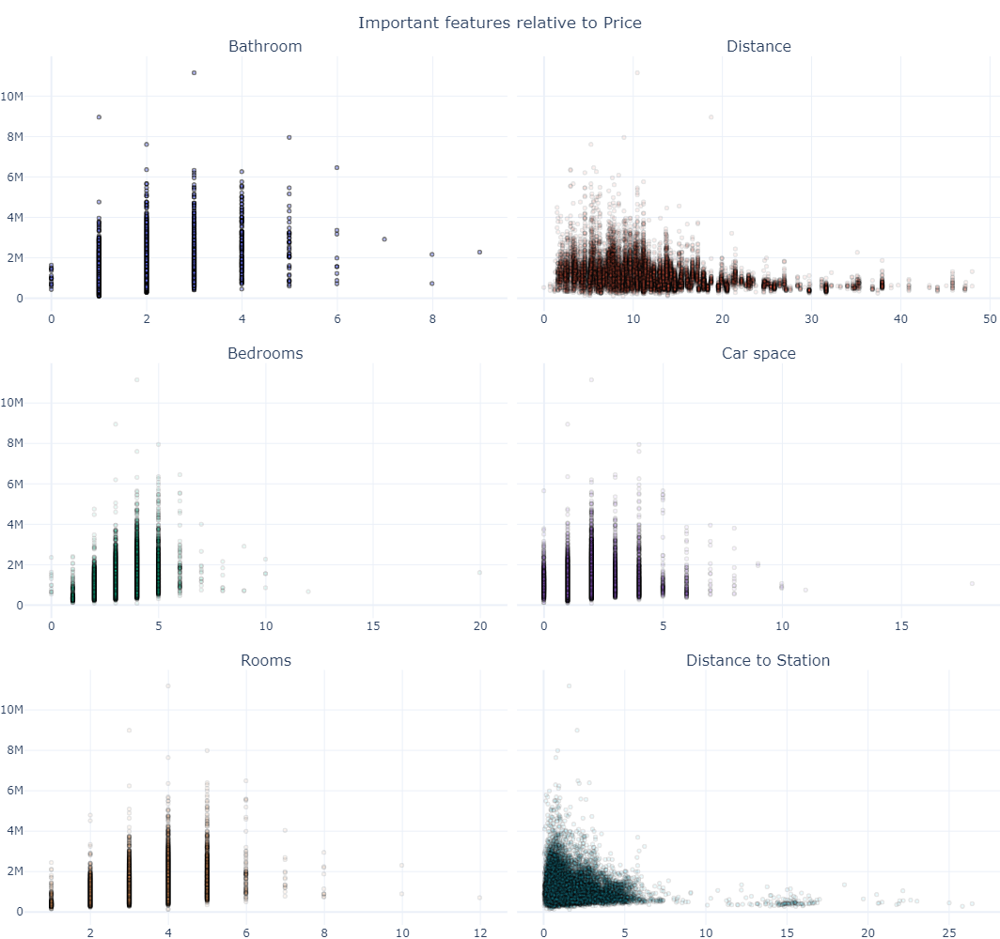

In [48]:
import plotly.graph_objs as go

from plotly.subplots import make_subplots
titles = ['Bathroom', 'Distance', 'Bedrooms', 'Car space', 'Rooms', 'Distance to Station']
fig = make_subplots(rows=3, cols=2,shared_yaxes=True,subplot_titles=titles,horizontal_spacing = 0.01, vertical_spacing = 0.06)

fig.add_trace(go.Scattergl(y=main_df_numer['Price'].values,x=main_df_numer['Bathroom'].values,mode='markers',name='Bathroom',text=main_df.index,opacity=0.5),row=1, col=1)
fig.add_trace(go.Scattergl(y=main_df_numer['Price'].values,x=main_df_numer['Distance'].values,mode='markers',name='Distance',text=main_df.index,opacity=0.1),row=1, col=2)
fig.add_trace(go.Scattergl(y=main_df_numer['Price'].values,x=main_df_numer['Bedrooms'].values,mode='markers',name='Bedrooms',text=main_df.index,opacity=0.1),row=2, col=1)
fig.add_trace(go.Scattergl(y=main_df_numer['Price'].values,x=main_df_numer['Car'].values,mode='markers',name='Car',text=main_df.index,opacity=0.1),row=2, col=2)
fig.add_trace(go.Scattergl(y=main_df_numer['Price'].values,x=main_df_numer['Rooms'].values,mode='markers',name='Rooms',text=main_df.index,opacity=0.1),row=3, col=1)
fig.add_trace(go.Scattergl(y=main_df_numer['Price'].values,x=main_df_numer['Distance_to_Station'].values,mode='markers',name='Distance to station',text=main_df.index,opacity=0.1),row=3, col=2)


fig.update_traces(marker=dict(size=4,line=dict(width=1.2,color='black')))
fig.update_layout(template='plotly_white',title={'text':'Important features relative to Price', 'xanchor': 'center', 'x':0.5},height=1000,showlegend= False)
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0})
fig.show()

#### Comment:
- Most houses have less than 5 bedrooms, 5 bathrooms and 5 rooms in total

- Most houses houses are under 30km to the CBD and 10km to the station in the suburbs

- Among 6 features above, 4 of them have positive correlation with Price, while Distance to CBD and Ditance to Station have negative one.

### 5.4 Geospartial plot

In [49]:
#sort data by name of suburb
geo_df = main_df.sort_values (['Suburb']).sample(2000).reset_index().drop(columns = ['index'])
geo_df

,Suburb,Address,Type,Method,SellerG,CouncilArea,Regionname,Rooms,Price,Distance,Postcode,Bedrooms,Bathroom,Car,Landsize,main_lat,main_lon,Propertycount,Sold_Month,Sold_Year,station,metro_lat,metro_lon,Distance_to_Station
0,Moorabbin,52 Bulli St,h,S,Buxton,Kingston City Council,Southern Metropolitan,3,1417250.0,14.6,3189.0,3.0,2.0,2.0,653.0,-37.94180,145.05490,2555.0,2.0,2016.0,Highett,-37.948096,145.041634,1.3577
1,Toorak,13 Bruce St,h,VB,Castran,Stonnington City Council,Southern Metropolitan,3,1900000.0,4.6,3142.0,3.0,2.0,1.0,268.0,-37.83690,145.00720,7217.0,11.0,2016.0,Hawksburn,-37.844668,145.002095,0.9732
2,Williamstown,4 Alma Tce,h,S,Williams,Hobsons Bay City Council,Western Metropolitan,2,1115000.0,6.8,3016.0,2.0,1.0,2.0,380.0,-37.85206,144.89318,6380.0,1.0,2018.0,North Williamstown,-37.856681,144.888757,0.6441
3,Wantirna,6 Magnolia St,h,SP,Harcourts,Knox City Council,Eastern Metropolitan,2,1280000.0,14.7,3152.0,2.0,1.0,0.0,1670.0,-37.83900,145.22143,5424.0,6.0,2017.0,Heathmont,-37.827850,145.244306,2.3608
4,Port Melbourne,2/8 Thomas St,h,S,Greg,Melbourne City Council,Southern Metropolitan,2,880000.0,3.8,3207.0,2.0,1.0,2.0,163.0,-37.83590,144.93580,8648.0,12.0,2016.0,Southern Cross,-37.818354,144.952193,2.4248
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,Altona North,11 Prismall St,h,S,Greg,Hobsons Bay City Council,Western Metropolitan,2,1025000.0,9.4,3025.0,2.0,1.0,2.0,702.0,-37.84260,144.86270,5132.0,11.0,2017.0,Newport,-37.842719,144.883604,1.8356
1996,Albion,2/36 Selwyn St,u,PI,Douglas,Brimbank City Council,Western Metropolitan,3,580000.0,13.9,3020.0,3.0,2.0,2.0,250.0,-37.77980,144.81560,2185.0,5.0,2017.0,Albion,-37.777656,144.824710,0.8354
1997,Brighton East,61 Marriage Rd,h,S,Hodges,Bayside City Council,Southern Metropolitan,4,2500000.0,10.3,3187.0,4.0,2.0,2.0,598.0,-37.91908,145.01332,6938.0,3.0,2018.0,Middle Brighton,-37.915135,144.996299,1.5562
1998,Prahran,37 Wrights Tce,h,S,Jellis,Stonnington City Council,Southern Metropolitan,3,1730000.0,4.5,3181.0,2.0,2.0,1.0,210.0,-37.85100,145.00510,7717.0,10.0,2016.0,Hawksburn,-37.844668,145.002095,0.7519


In [50]:
import folium

m = folium.Map(location=[-37.840935, 144.946457], zoom_start=15)
tooltip = "Click Here For More Info"

for i in range (len (main_df[:2000])):
    marker = folium.Marker (
    location = [main_df['main_lat'][i], main_df['main_lon'][i]],
                popup = '<stong>Nothing to display</stong>',
                tooltip = [main_df['Address'][i], main_df['Price'][i]])
    
    marker.add_to (m)

m

*Selling houses are located in clusters and mostly close the railway and stations*

# 6. Data Preparation For Modeling

### *6.1. Removing outliers*

Look at the scatter plots above, we can easily see that there are so many outliers. They need to be removed before we apply the data into training set!

In [51]:
main_df

,Suburb,Address,Type,Method,SellerG,CouncilArea,Regionname,Rooms,Price,Distance,Postcode,Bedrooms,Bathroom,Car,Landsize,main_lat,main_lon,Propertycount,Sold_Month,Sold_Year,station,metro_lat,metro_lon,Distance_to_Station
0,Abbotsford,85 Turner St,h,S,Biggin,Yarra City Council,Northern Metropolitan,2,1480000.0,2.5,3067.0,2.0,1.0,1.0,202.0,-37.79960,144.99840,4019.0,12.0,2016.0,Victoria Park,-37.799381,144.994407,0.3517
1,Abbotsford,25 Bloomburg St,h,S,Biggin,Yarra City Council,Northern Metropolitan,2,1035000.0,2.5,3067.0,2.0,1.0,0.0,156.0,-37.80790,144.99340,4019.0,2.0,2016.0,North Richmond,-37.810076,144.992556,0.2531
2,Abbotsford,5 Charles St,h,SP,Biggin,Yarra City Council,Northern Metropolitan,3,1465000.0,2.5,3067.0,3.0,2.0,0.0,134.0,-37.80930,144.99440,4019.0,3.0,2017.0,North Richmond,-37.810076,144.992556,0.1835
3,Abbotsford,40 Federation La,h,PI,Biggin,Yarra City Council,Northern Metropolitan,3,850000.0,2.5,3067.0,3.0,2.0,1.0,94.0,-37.79690,144.99690,4019.0,3.0,2017.0,Victoria Park,-37.799381,144.994407,0.3523
4,Abbotsford,55a Park St,h,VB,Nelson,Yarra City Council,Northern Metropolitan,4,1600000.0,2.5,3067.0,3.0,1.0,2.0,120.0,-37.80720,144.99410,4019.0,6.0,2016.0,Collingwood,-37.804543,144.993743,0.2971
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15710,Wollert,35 Kingscote Wy,h,SP,RW,Whittlesea City Council,Northern Metropolitan,3,570000.0,25.5,3750.0,3.0,2.0,2.0,404.0,-37.61031,145.03393,2940.0,2.0,2018.0,Epping,-37.653017,145.028607,4.7719
15711,Yarraville,78 Bayview Rd,h,S,Jas,Maribyrnong City Council,Western Metropolitan,3,1101000.0,6.3,3013.0,3.0,1.0,2.0,288.0,-37.81095,144.88516,6543.0,2.0,2018.0,Yarraville,-37.815813,144.889975,0.6865
15712,Yarraville,29A Murray St,h,SP,Sweeney,Maribyrnong City Council,Western Metropolitan,2,888000.0,6.3,3013.0,2.0,2.0,1.0,98.0,-37.81551,144.88826,6543.0,2.0,2018.0,Yarraville,-37.815813,144.889975,0.1544
15713,Yarraville,147A Severn St,t,S,Jas,Maribyrnong City Council,Western Metropolitan,2,705000.0,6.3,3013.0,2.0,1.0,2.0,220.0,-37.82286,144.87856,6543.0,2.0,2018.0,Spotswood,-37.830651,144.885942,1.0821


In [52]:
#using Z_score
from scipy import stats
z_value = np.abs (stats.zscore (main_df_numer.iloc[:, 1:]))
z_value

,Price,Bathroom,Distance,Bedrooms,Car,Rooms,Distance_to_Station,Landsize,main_lon,main_lat
0,0.504647,0.874444,1.367560,1.292938,0.765095,1.338176,0.737166,0.116089,0.009696,0.049928
1,0.170229,0.874444,1.367560,1.292938,1.756558,1.338176,0.792458,0.127554,0.031050,0.039595
2,0.481899,0.532671,1.367560,0.178556,1.756558,0.203413,0.831487,0.133037,0.022901,0.054695
3,0.450796,0.532671,1.367560,0.178556,0.765095,0.203413,0.736830,0.143007,0.002528,0.079050
4,0.686637,0.874444,1.367560,0.178556,0.226368,0.931351,0.767784,0.136527,0.025346,0.032045
...,...,...,...,...,...,...,...,...,...,...
15710,0.875438,0.532671,2.041599,0.178556,0.226368,0.203413,1.741536,0.065744,0.299244,2.091590
15711,0.070135,0.874444,0.804308,0.178556,0.226368,0.203413,0.549421,0.094655,0.913139,0.072492
15712,0.393166,0.532671,0.804308,1.292938,0.765095,1.338176,0.847805,0.142010,0.887876,0.121675
15713,0.670700,0.874444,0.804308,1.292938,0.226368,1.338176,0.327582,0.111603,0.966924,0.200952


In [53]:
#Clear out data that lay out of the range [-3 < z < 3]
main_df_numer_after_z = main_df_numer[(z_value < 3).all(axis = 1)]
main_df_numer_after_z

,Address,Price,Bathroom,Distance,Bedrooms,Car,Rooms,Distance_to_Station,Landsize,main_lon,main_lat
0,85 Turner St,1480000.0,1.0,2.5,2.0,1.0,2,0.3517,202.0,144.99840,-37.79960
1,25 Bloomburg St,1035000.0,1.0,2.5,2.0,0.0,2,0.2531,156.0,144.99340,-37.80790
2,5 Charles St,1465000.0,2.0,2.5,3.0,0.0,3,0.1835,134.0,144.99440,-37.80930
3,40 Federation La,850000.0,2.0,2.5,3.0,1.0,3,0.3523,94.0,144.99690,-37.79690
4,55a Park St,1600000.0,1.0,2.5,3.0,2.0,4,0.2971,120.0,144.99410,-37.80720
...,...,...,...,...,...,...,...,...,...,...,...
15710,35 Kingscote Wy,570000.0,2.0,25.5,3.0,2.0,3,4.7719,404.0,145.03393,-37.61031
15711,78 Bayview Rd,1101000.0,1.0,6.3,3.0,2.0,3,0.6865,288.0,144.88516,-37.81095
15712,29A Murray St,888000.0,2.0,6.3,2.0,1.0,2,0.1544,98.0,144.88826,-37.81551
15713,147A Severn St,705000.0,1.0,6.3,2.0,2.0,2,1.0821,220.0,144.87856,-37.82286


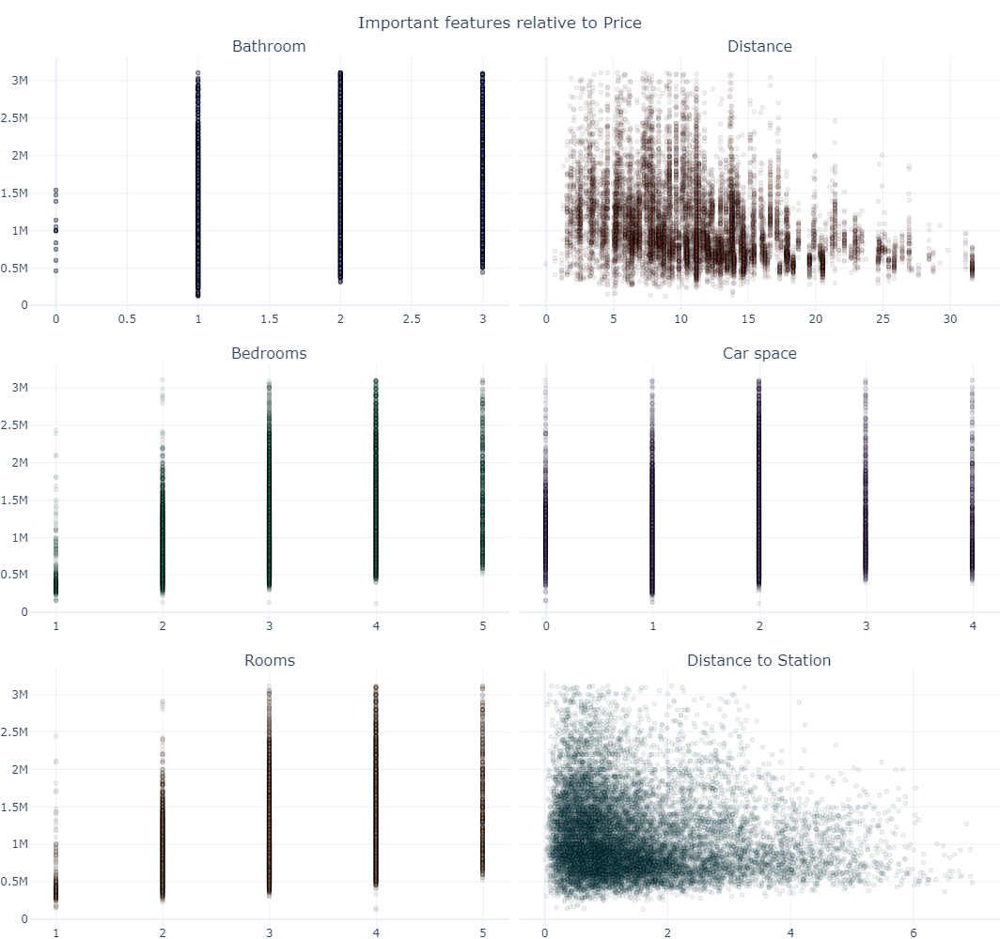

In [54]:
from plotly.subplots import make_subplots
titles = ['Bathroom', 'Distance', 'Bedrooms', 'Car space', 'Rooms', 'Distance to Station']
fig = make_subplots(rows=3, cols=2,shared_yaxes=True,subplot_titles=titles,horizontal_spacing = 0.01, vertical_spacing = 0.06)

fig.add_trace(go.Scattergl(y=main_df_numer_after_z['Price'].values,x=main_df_numer_after_z['Bathroom'].values,mode='markers',name='Bathroom',text=main_df.index,opacity=0.5),row=1, col=1)
fig.add_trace(go.Scattergl(y=main_df_numer_after_z['Price'].values,x=main_df_numer_after_z['Distance'].values,mode='markers',name='Distance',text=main_df.index,opacity=0.1),row=1, col=2)
fig.add_trace(go.Scattergl(y=main_df_numer_after_z['Price'].values,x=main_df_numer_after_z['Bedrooms'].values,mode='markers',name='Bedrooms',text=main_df.index,opacity=0.1),row=2, col=1)
fig.add_trace(go.Scattergl(y=main_df_numer_after_z['Price'].values,x=main_df_numer_after_z['Car'].values,mode='markers',name='Car',text=main_df.index,opacity=0.1),row=2, col=2)
fig.add_trace(go.Scattergl(y=main_df_numer_after_z['Price'].values,x=main_df_numer_after_z['Rooms'].values,mode='markers',name='Rooms',text=main_df.index,opacity=0.1),row=3, col=1)
fig.add_trace(go.Scattergl(y=main_df_numer_after_z['Price'].values,x=main_df_numer_after_z['Distance_to_Station'].values,mode='markers',name='Distance to station',text=main_df.index,opacity=0.1),row=3, col=2)


fig.update_traces(marker=dict(size=4,line=dict(width=1.2,color='black')))
fig.update_layout(template='plotly_white',title={'text':'Important features relative to Price', 'xanchor': 'center', 'x':0.5},height=1000,showlegend= False)
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0})
fig.show()

*Data appears to have less outliers on both sides*

### *6.2. Features correlation after outliers removal*

<AxesSubplot:title={'center':'Features correlation after removing outliers'}>

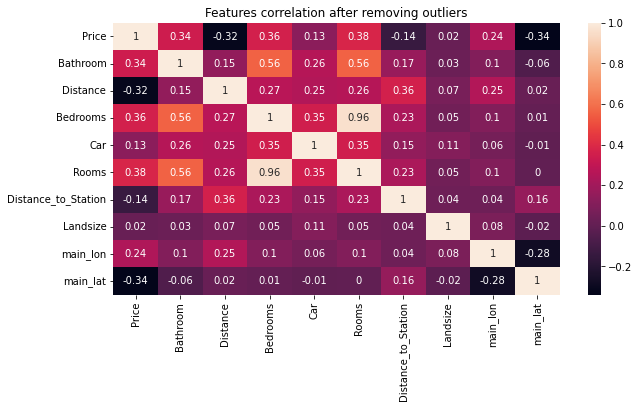

In [55]:
plt.figure (figsize = (10, 5))
plt.title ('Features correlation after removing outliers')
sns.heatmap (main_df_numer_after_z.corr().round(2), annot = True)

> After scaling data with Normal distribution, Bathrooms, Distance, Bedrooms, Total rooms, Longtitude and Lattitude seem to have stronger affects on Price, unless Distance to nearest station perform worse than before!

### *6.3. Clean unrelated data*

- *Postcode*, *Suburb*, *Council Area*, *Regionname* are 4 features that equally and significantly affect Price. However, these are categorical data and instead, we can use Longtitude and Lattitude (numerical data) as alternative features, then we could drop those 4 features.
- *Method*, *Seller* should also be dropped because they seems to have no effect on Price

In [56]:
output_df = main_df.merge (main_df_numer_after_z, on = ['Address', 'Price', 'Bathroom', 'Distance', 'Bedrooms', 'Car', 'Rooms', 'Distance_to_Station', 'Landsize'], how = 'right')

output_main = main_df.merge (main_df_numer_after_z, on = ['Address', 'Price', 'Bathroom', 'Distance', 'Bedrooms', 'Car', 'Rooms', 'Distance_to_Station', 'Landsize', 'main_lon', 'main_lat'], how = 'right')

use_data = output_main.drop(columns = ['Suburb', 'Address', 'Method', 'SellerG', 'CouncilArea', 'Regionname', 'station', 'Postcode', 'Propertycount', 'Sold_Year', 'Sold_Month', 'metro_lat', 'metro_lon'])
use_data.head()

,Type,Rooms,Price,Distance,Bedrooms,Bathroom,Car,Landsize,main_lat,main_lon,Distance_to_Station
0,h,2,1480000.0,2.5,2.0,1.0,1.0,202.0,-37.7996,144.9984,0.3517
1,h,2,1035000.0,2.5,2.0,1.0,0.0,156.0,-37.8079,144.9934,0.2531
2,h,3,1465000.0,2.5,3.0,2.0,0.0,134.0,-37.8093,144.9944,0.1835
3,h,3,850000.0,2.5,3.0,2.0,1.0,94.0,-37.7969,144.9969,0.3523
4,h,4,1600000.0,2.5,3.0,1.0,2.0,120.0,-37.8072,144.9941,0.2971


### *6.3. Feature Importance*

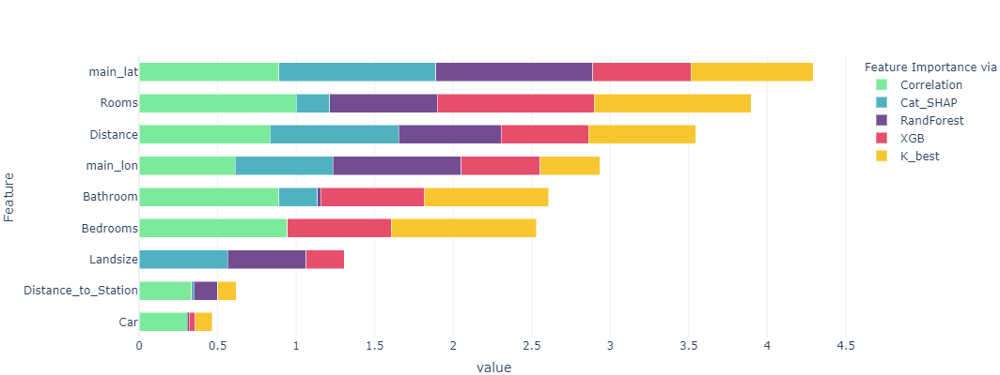

In [57]:
transformer(feature_importance=True,figsize=(800,400),target='Price').transform(X=use_data)

### *6.4. Normalization & Categorical Encoder*
*Using Standard Normalization*

In [58]:
from sklearn.preprocessing import StandardScaler

#create dummies from "type"
dummy_type = pd.get_dummies(use_data[['Type']])
use_data = dummy_type.merge (use_data, left_index = True, right_index = True).drop(columns = ['Type'])
use_data.head(5)

features = use_data.drop(columns = ['Price'])
price_ = use_data['Price']

features_ = StandardScaler().fit_transform (features)
features_

array([[ 0.45618255, -0.2903412 , -0.32307288, ...,  0.01412583,
         0.01586957, -0.99409101],
       [ 0.45618255, -0.2903412 , -0.32307288, ..., -0.08469562,
        -0.02803126, -1.07821307],
       [ 0.45618255, -0.2903412 , -0.32307288, ..., -0.1013643 ,
        -0.01925109, -1.13759335],
       ...,
       [ 0.45618255, -0.2903412 , -0.32307288, ..., -0.1753018 ,
        -0.95117781, -1.16242045],
       [-2.19210488,  3.44422358, -0.32307288, ..., -0.26281236,
        -1.03634541, -0.37093936],
       [ 0.45618255, -0.2903412 , -0.32307288, ..., -0.20613885,
        -0.90508195, -0.95168872]])

# 7. BUILDING MODELS

In [59]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(features_, price_, test_size=0.2, random_state= 42)

In [60]:
X_train.shape

(11689, 12)

LR:  -120549475146.65817 7314097821.926731
LASSO:  -120543426022.74658 7295837818.106385
EN:  -134567608716.6219 7352670636.696679
KNN:  -75608538403.83495 3060141830.7825136
CART:  -102667693702.0502 9509497313.494534
ABR:  -138857361874.24976 7877682751.899962
GBR:  -61489184427.339745 3692153996.2809434
RFR:  -50256440077.03551 3166918661.431122
XGB:  -48662609402.90767 3295074753.3566537


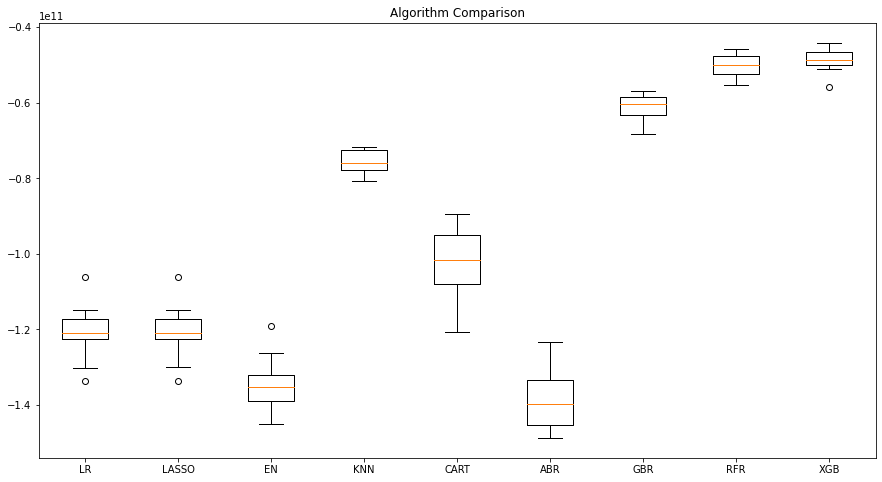

In [61]:
# from catboost import CatBoostRegressor
from xgboost import XGBRegressor
from sklearn.gaussian_process import GaussianProcessRegressor as GPR
from sklearn.gaussian_process.kernels import ConstantKernel, RBF
from sklearn.ensemble import (RandomForestRegressor,GradientBoostingRegressor,
                              ExtraTreesRegressor,AdaBoostRegressor)
from sklearn.linear_model import LinearRegression,Lasso,ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split # Data Split
from sklearn.model_selection import cross_val_score # Cross Validation
from sklearn.model_selection import StratifiedKFold # K-Fold Cross Validation

''' Evaluate some promising models '''
# let's look at how models perform overall, using default settings

models = [] 
models.append(('LR',  LinearRegression()))
models.append(('LASSO',Lasso()))
models.append(('EN',ElasticNet()))  
models.append(('KNN',KNeighborsRegressor()))        
models.append(('CART',DecisionTreeRegressor()))     
models.append(('ABR', AdaBoostRegressor()))
models.append(('GBR', GradientBoostingRegressor()))
models.append(('RFR', RandomForestRegressor(random_state=3)))
models.append(('XGB', XGBRegressor(verbose_eval=False)))

# Evaluate each model in turn using cross-validation
results, names = [], []
for name, model in models:
	kfold = StratifiedKFold(n_splits=10, random_state=3, shuffle=True)
	model_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='neg_mean_squared_error')
	results.append(model_results)
	names.append(name)
	print(name + ": ", model_results.mean(), model_results.std())

#Compare algorithms using boxplots
plt.figure(figsize=(15,8))
plt.boxplot(results, labels=names)
plt.title('Algorithm Comparison')
plt.show()

In [73]:
#testing
from sklearn import metrics
scores = dict()
for name, model in models:
    model.fit(X_train, y_train)
    predictions = model.predict(X_test)
    scores[name] = metrics.mean_squared_error(y_test, predictions)
    print(name + 'MSE:' + str(metrics.mean_squared_error(y_test, predictions)))

LRMSE:120945127849.52908
LASSOMSE:120948603550.48279
ENMSE:137890602618.69775
KNNMSE:74191180629.17726
CARTMSE:99306553879.14882
ABRMSE:130395903851.34459
GBRMSE:61948811748.959564
RFRMSE:49007504892.920074
XGBMSE:48371624939.33722


> Our baseline models show no sign of overfitting, 'mse' at testing and trainning set are approximately similar!

### *Should we use PCA to improve training time?*

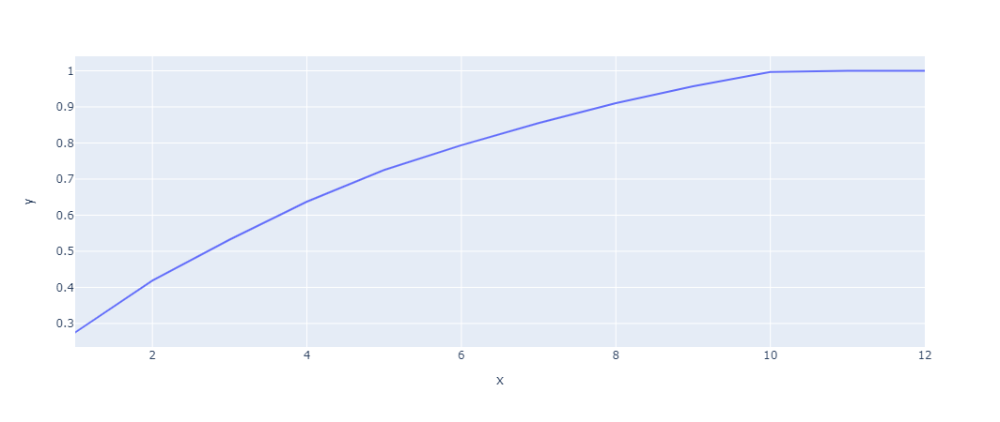

In [63]:
from sklearn.decomposition import PCA

def explained_var_ratio (number_of_components):
    pca = PCA (n_components = number_of_components)
    principalComponents = pca.fit_transform (X_train)
    return np.sum(pca.explained_variance_ratio_)

sum_ratio = []
for i in range (1, 13):
    sum_ratio.append (explained_var_ratio (i))

fig = px.line(x=[i for i in range(1, 13)], y=sum_ratio)
fig.show()

In [64]:
#Choose n_components = 10 
pca = PCA (n_components = 10)
principalComponents = pca.fit_transform (features_)

LR:  -120597761804.15877 7303447080.109921
LASSO:  -120597760482.39995 7303401479.771138
EN:  -134578798049.45593 7354890984.187739
KNN:  -74474314856.3213 2890682528.77817
CART:  -132748597567.18436 5241341465.6279955
ABR:  -147392881285.4024 7070979245.468157
GBR:  -78685173135.13985 3776557305.854634
RFR:  -65069100793.32666 3119889731.9643145
XGB:  -68626458189.674416 3967176742.6890225


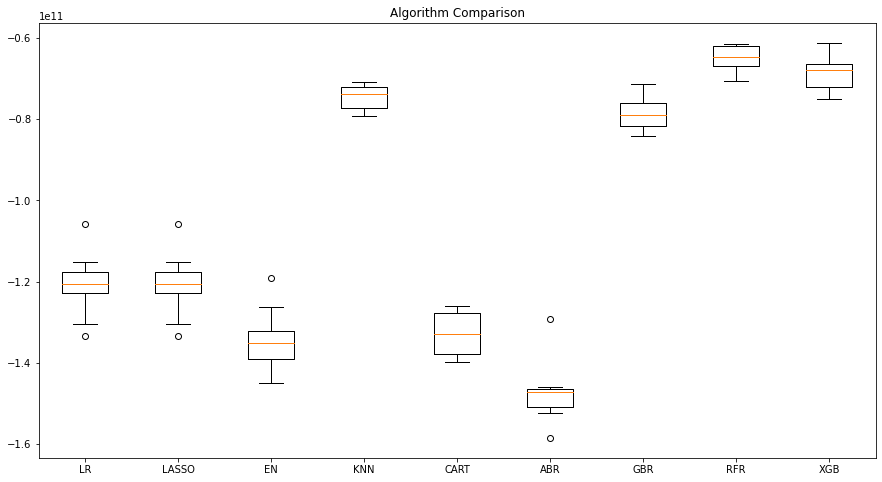

GBRMSE:78566401158.94574
RFRMSE:61251055662.29281
XGBMSE:64064826812.798676


In [65]:
#train-test split
X_pca_train, X_pca_test, y_pca_train, y_pca_test = train_test_split(principalComponents, price_, test_size=0.2, random_state= 42)

models_pca = [] 
models_pca.append(('LR',  LinearRegression()))
models_pca.append(('LASSO',Lasso()))
models_pca.append(('EN',ElasticNet()))  
models_pca.append(('KNN',KNeighborsRegressor()))        
models_pca.append(('CART',DecisionTreeRegressor()))     
models_pca.append(('ABR', AdaBoostRegressor()))
models_pca.append(('GBR', GradientBoostingRegressor()))
models_pca.append(('RFR', RandomForestRegressor()))
models_pca.append(('XGB', XGBRegressor(verbose_eval=False)))

# Evaluate each model in turn using cross-validation
results_pca, names_pca = [], []
for name, model in models:
	kfold = StratifiedKFold(n_splits=10, random_state=3, shuffle=True)
	model_results = cross_val_score(model, X_pca_train, y_pca_train, cv=kfold, scoring='neg_mean_squared_error')
	results_pca.append(model_results)
	names_pca.append(name)
	print(name + ": ", model_results.mean(), model_results.std())

#Compare algorithms using boxplots
plt.figure(figsize=(15,8))
plt.boxplot(results_pca, labels=names)
plt.title('Algorithm Comparison')
plt.show()

#testing

#testing
from sklearn import metrics
for name, model in models_pca[-3:]:
    model.fit(X_pca_train, y_pca_train)
    predictions = model.predict(X_pca_test)
    print(name + 'MSE:' + str(metrics.mean_squared_error(y_pca_test, predictions)))


*Comparing to the mse calculated with the initial train-test array, the mse when applying PCA is much higher.*

*-> We will take the initial models.*

## Hyperparameter tuning

### *Random Forest Regressor*
In this grid search we will try different combinations of Random Forest hyperparameters.



#### Most important hyperparameters of Random Forest:

n_estimators = n of trees

max_depth = max number of levels in each decision tree

bootstrap = method for sampling data points (with or without replacement)

Here, we will choose parameters using GridSearchCV with 5-fold cross validations.

The scoring is set to *neg_mean_squared_error* to compute the MSE of the model. n_jobs=-1 means that we will use all the processors to boost the running time.

Let's see how well this model performs!

In [68]:
from sklearn.model_selection import GridSearchCV

n_estimators = [64, 128, 256, 512, 1024]
max_depth = np.linspace(1, 32, 16, endpoint=True)
min_samples_splits = np.linspace(0.1, 1.0, 10, endpoint=True)
min_samples_leafs = np.linspace(0.1, 0.5, 5, endpoint=True)

param_grid = {
    "n_estimators": n_estimators,
    "max_depth": max_depth,
    "bootstrap": [True, False]
}

forest = RandomForestRegressor(n_jobs=-1, random_state=3) 

grid_search_forest = GridSearchCV(forest, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search_forest.fit(X_train, y_train)
cvres = grid_search_forest.cv_results_

grid_search_forest.best_estimator_

grid_best= grid_search_forest.best_estimator_.predict(X_test)

from sklearn.metrics import mean_squared_error

grid_mse = mean_squared_error(y_test, grid_best)
 


In [75]:
print (grid_mse /scores['RFR'])

0.9919382374960793


> After conducting hyperpararameter tuning for Random Forest model, we can see 1% improvement in MSE of the prediction prices.

### *XGBoost Regressor*

For this model, we will also choose parameters using GridSearchCV with 5-fold cross validations.

In [76]:
xgb_hyperparameters_grid1 = {
    "n_estimators": [i for i in range (50, 150, 10)],
    "learning_rate": [0.1, 0.2, 0.3],
    "max_depth": [i for i in range (11)],
    "bootstrap" : [True, False]
}
    
model_xgb = XGBRegressor(n_jobs = -1)

xgb_grid_search1 = GridSearchCV(
    model_xgb, xgb_hyperparameters_grid1, cv = 5, scoring = "neg_mean_squared_error")
xgb_grid_search1.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    gamma=None, gpu_id=None, grow_policy=None,
                                    importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_bin=None,
                                    max_cat...
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None, n_estimators=100,
                                    n_jobs=-1, num_parallel_tree=None,
                                

In [77]:
grid_best= xgb_grid_search1.best_estimator_.predict(X_test)

In [78]:
xgb_grid_search1.best_params_

{'bootstrap': True, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 140}

In [79]:
grid_mse = mean_squared_error(y_test, grid_best)

In [80]:
print (grid_mse /scores['XGB'])

0.9566769111510363


> After conducting hyperpararameter tuning for XGBoost model, we can see 4% improvement in MSE of the prediction prices.

# CONCLUSION
In this project, we have utilized real historical housing transactions to derive valuable insights into the Melbourne housing market.

Also, we've trained and conducted hyperparameter tuning and PCA on different models to predict house prices which helps home buyers to make better decisions.

After all, we end up with two best models (Random Forest Regressor and XGBoost Regressor) which seem to perform well on this dataset with no sign of overfitting.

# Thank you for your attention!
---